In [1]:
import os
import zipfile
from concurrent.futures import ThreadPoolExecutor

import gdown
import kagglehub
import numpy as np
from sklearn.model_selection import train_test_split
from PIL import Image

from datasets import load_dataset
from src.data_preparation_utils import RESULTS_DIR, save_batch
from src.data_utils import process_image
from src.utils import plot_images

# Our dataset

In [2]:
train_length = val_length = test_length = 0
sample_images = sample_labels = None

for file in os.listdir(RESULTS_DIR):
    if file.startswith("train") and file.endswith(".npz"):
        data = np.load(os.path.join(RESULTS_DIR, file))

        if sample_images is None:
            sample_images = data["images"][:20]
            sample_labels = data["labels"][:20]

        train_length += len(data["images"])

    elif file.startswith("val") and file.endswith(".npz"):
        data = np.load(os.path.join(RESULTS_DIR, file))
        val_length += len(data["images"])

    elif file.startswith("test") and file.endswith(".npz"):
        data = np.load(os.path.join(RESULTS_DIR, file))
        test_length += len(data["images"])

print(f"Train length: {train_length}")
print(f"Validation length: {val_length}")
print(f"Test length: {test_length}")

Train length: 80000
Validation length: 10000
Test length: 10000


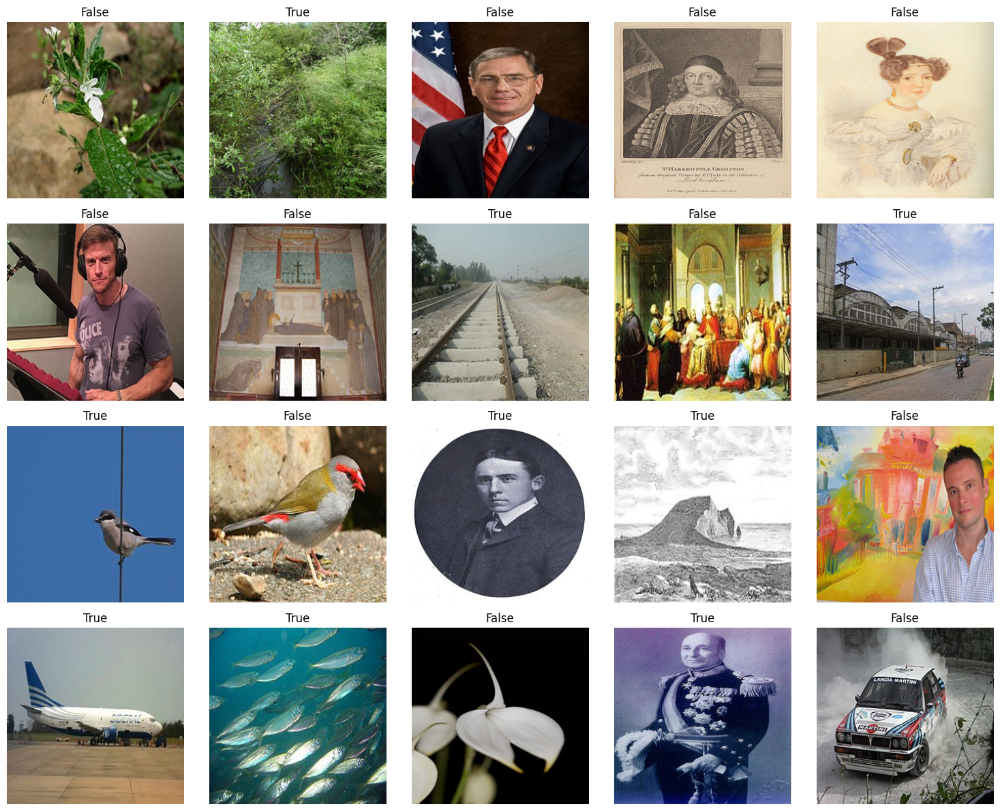

In [3]:
plot_images(
    sample_images,
    ncols=5,
    labels=sample_labels,
)

Labels are not the best, but we won't get any better with existing small open source models. Further work for that project would be for sure trying to generate better dataset using state-of-the-art MLLMs like chatgpt o3. However, providing required length of the dataset, it won't be cheap. Moreover, this dataset should be filtered out of images irrelevant to the cause, ex charts, maps, paintings and more.

# Additional datasets

We'll use all 'good' images for training, and latter upper poorer dataset for further training - at each iteration besides training we'll try to remove instances that are most likely irrelevant for our project.

In [9]:
def save(
    name: str, images: np.ndarray, labels: np.ndarray, batch_size: int = 1000
) -> None:
    """
    Save the images and labels to a file.
    """
    train, val_test = train_test_split(
        np.arange(len(images)),
        test_size=0.2,
        random_state=42,
    )
    val, test = train_test_split(
        val_test,
        test_size=0.5,
        random_state=42,
    )

    print(f"Train length: {len(train)}")
    print(f"Validation length: {len(val)}")
    print(f"Test length: {len(test)}")

    for portion_name, portion in zip(["train", "val", "test"], [train, val, test]):
        cur_images = images[portion]
        cur_labels = labels[portion]

        images_batches = [
            cur_images[i : i + batch_size] for i in range(0, len(portion), batch_size)
        ]
        labels_batches = [
            cur_labels[i : i + batch_size] for i in range(0, len(portion), batch_size)
        ]

        for i, (images_batch, labels_batch) in enumerate(
            zip(images_batches, labels_batches)
        ):
            save_batch(
                i,
                images_batch,
                labels_batch,
                f"{name}_{portion_name}",
            )

## [Indoor-Outdoor Net](https://huggingface.co/datasets/prithivMLmods/IndoorOutdoorNet-20K)

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


0000.parquet:   0%|          | 0.00/451M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/19998 [00:00<?, ? examples/s]

Number of images: 19998


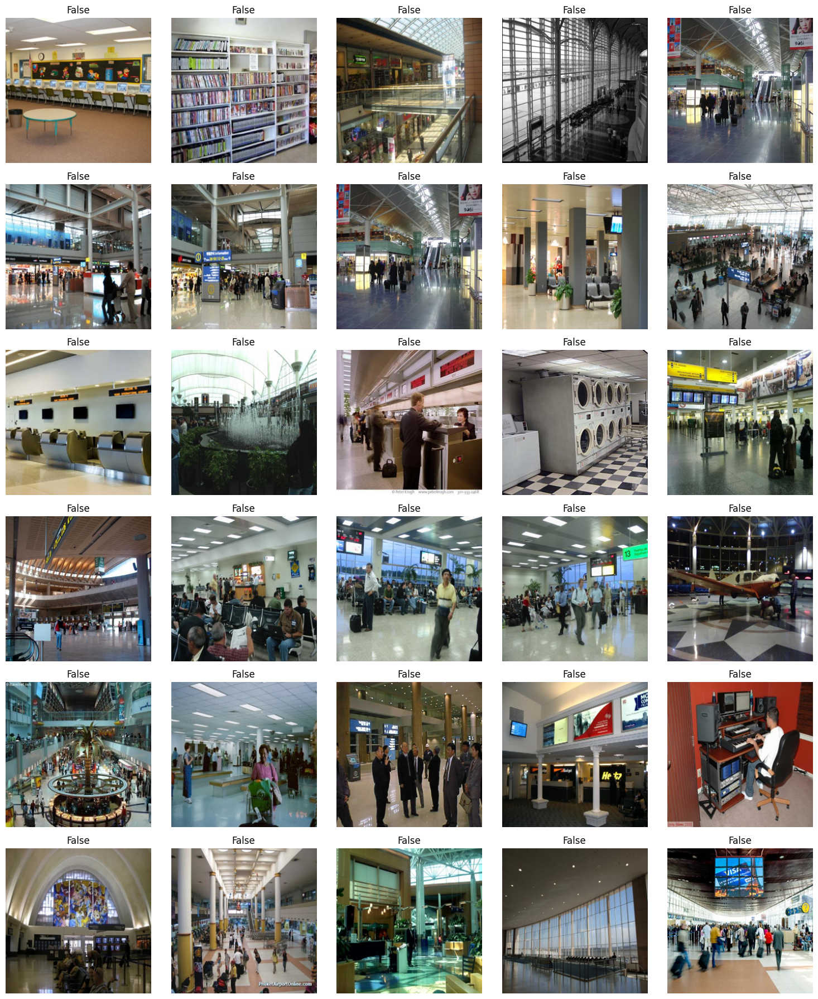

In [16]:
dataset = load_dataset("prithivMLmods/IndoorOutdoorNet-20K")

images = dataset["train"]["image"]
labels = np.array(dataset["train"]["label"], dtype=np.bool_)

print(f"Number of images: {len(images)}")

with ThreadPoolExecutor() as executor:
    images = np.array(list(executor.map(process_image, images)))

plot_images(
    images[:30],
    ncols=5,
    labels=labels[:30],
)

In [17]:
save("indoor-outdoor", images, labels)

Train length: 15998
Validation length: 2000
Test length: 2000


## [MIT Indoor Scenes](https://www.kaggle.com/datasets/itsahmad/indoor-scenes-cvpr-2019)

In [6]:
path = kagglehub.dataset_download("itsahmad/indoor-scenes-cvpr-2019")

os.listdir(path)

100%|██████████| 2.34G/2.34G [04:03<00:00, 10.3MB/s]

Extracting files...


['indoorCVPR_09',
 'indoorCVPR_09annotations',
 'TestImages.txt',
 'TrainImages.txt']

Number of images: 15619


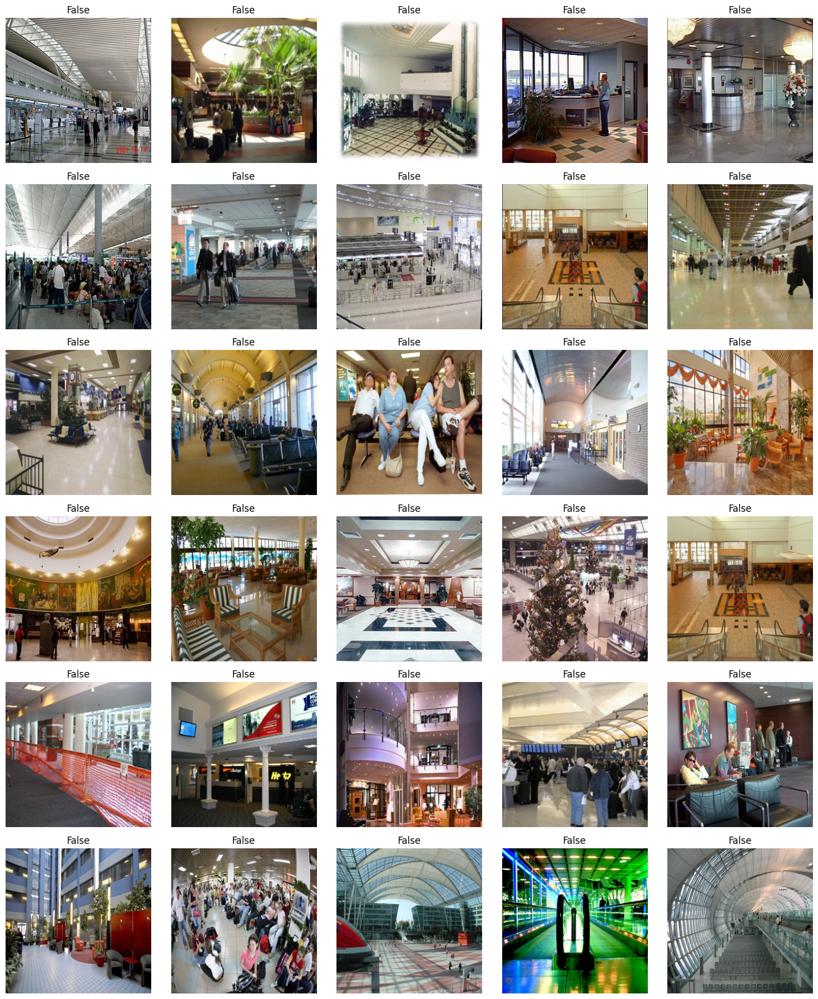

In [7]:
dir_path = os.path.join(path, "indoorCVPR_09")
image_paths = []
for root_dir, dirs, files in os.walk(dir_path):
    for file in files:
        if file.lower().endswith(".jpg"):
            image_paths.append(os.path.join(root_dir, file))

print(f"Number of images: {len(image_paths)}")

with ThreadPoolExecutor() as executor:
    images = np.array(list(executor.map(process_image, image_paths)))
labels = np.zeros(len(images), dtype=np.bool_)

plot_images(
    images[:30],
    ncols=5,
    labels=labels[:30],
)

In [10]:
save("mit", images, labels)

Train length: 12495
Validation length: 1562
Test length: 1562


## [Landsaping Pictures](https://www.kaggle.com/datasets/arnaud58/landscape-pictures)

100%|██████████| 620M/620M [01:00<00:00, 10.7MB/s] 

Extracting files...


Number of images: 4319


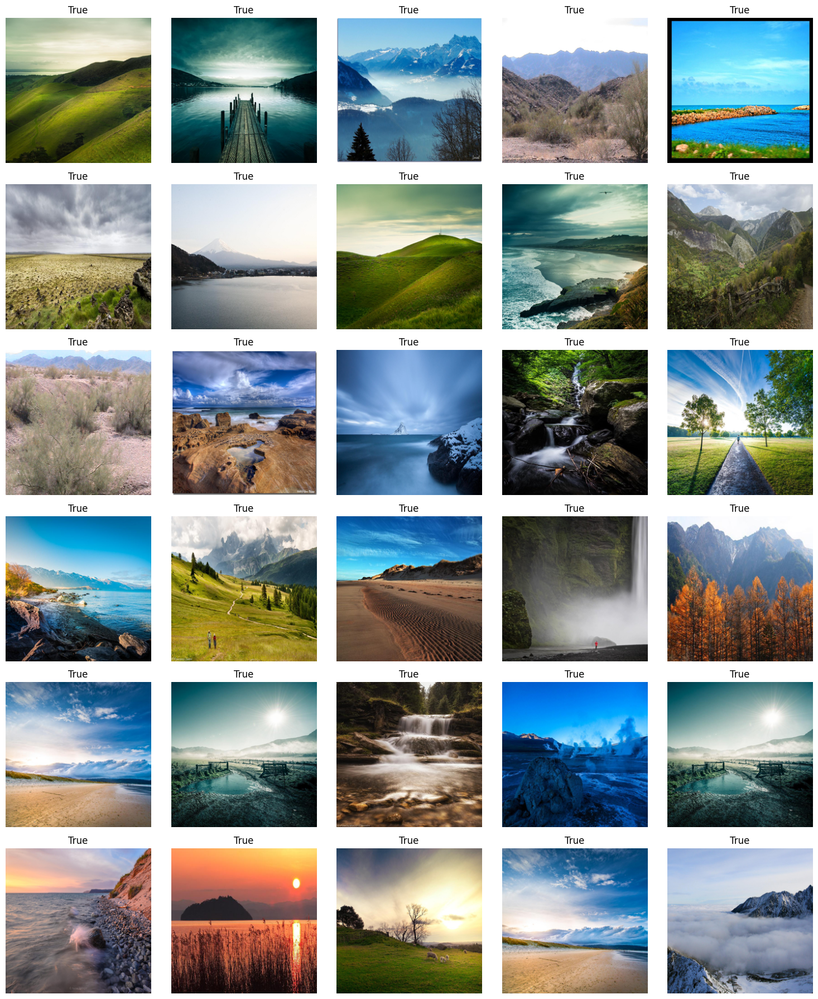

In [11]:
path = kagglehub.dataset_download("arnaud58/landscape-pictures")

image_paths = [
    os.path.join(path, f) for f in os.listdir(path) if f.lower().endswith(".jpg")
]

print(f"Number of images: {len(image_paths)}")

with ThreadPoolExecutor() as executor:
    images = np.array(list(executor.map(process_image, image_paths)))
labels = np.ones(len(images), dtype=np.bool_)

plot_images(
    images[:30],
    ncols=5,
    labels=labels[:30],
)

In [12]:
save("landscape", images, labels)

Train length: 3455
Validation length: 432
Test length: 432


## [OST 300](https://paperswithcode.com/dataset/ost300)

In [13]:
output_dir = os.path.join(RESULTS_DIR, "ost-300")

if not os.path.exists(output_dir):
    os.makedirs(output_dir, exist_ok=True)
    folder_url = (
        "https://drive.google.com/drive/folders/16PIViLkv4WsXk4fV1gDHvEtQxdMq6nfY"
    )
    gdown.download_folder(
        url=folder_url, output=output_dir, quiet=False, use_cookies=False
    )

    for file_name in os.listdir(output_dir):
        if file_name.lower().endswith(".zip"):
            zip_path = os.path.join(output_dir, file_name)
            print(f"Extracting {zip_path}...")
            with zipfile.ZipFile(zip_path, "r") as z:
                z.extractall(output_dir)
            os.remove(zip_path)

Retrieving folder contents


Processing file 18j0Hs3jYKWlEWXe2YAO6G_N7necFPoNF animal.zip
Processing file 1e7wy2orGpDny6r0TXMdHGU4Dl1W0O8ZM building.zip
Processing file 1-QTD-6f2YWWu5H1ZyHjrU-_0XXQlMlpP grass.zip
Processing file 1aLIMRqRSWkm_Aad8vP6J6cTmU7S2bHbo mountain.zip
Processing file 1EeUCukqpBKTlXgP1s-vG3zrFc1__qaAF plant.zip
Processing file 1k8mtKqwdpBx_O6p1CnJPiMd7yTBn-7bX sky.zip
Processing file 19i51Zy5geIiHxsg_6pFhNZNbEnhPCogx water.zip


Retrieving folder contents completed
Building directory structure
Building directory structure completed
Downloading...
From (original): https://drive.google.com/uc?id=18j0Hs3jYKWlEWXe2YAO6G_N7necFPoNF
From (redirected): https://drive.google.com/uc?id=18j0Hs3jYKWlEWXe2YAO6G_N7necFPoNF&confirm=t&uuid=c699128e-450c-4c85-95a7-3b68a0701747
To: c:\Users\pawpo\Desktop\Indoor-Outdoor\datasets\ost-300\animal.zip
100%|██████████| 1.11G/1.11G [01:45<00:00, 10.5MB/s]
Downloading...
From (original): https://drive.google.com/uc?id=1e7wy2orGpDny6r0TXMdHGU4Dl1W0O8ZM
From (redirected): https://drive.google.com/uc?id=1e7wy2orGpDny6r0TXMdHGU4Dl1W0O8ZM&confirm=t&uuid=7e67c8a7-f978-4e0c-9ad4-446d869821e3
To: c:\Users\pawpo\Desktop\Indoor-Outdoor\datasets\ost-300\building.zip
100%|██████████| 856M/856M [01:31<00:00, 9.38MB/s] 
Downloading...
From (original): https://drive.google.com/uc?id=1-QTD-6f2YWWu5H1ZyHjrU-_0XXQlMlpP
From (redirected): https://drive.google.com/uc?id=1-QTD-6f2YWWu5H1ZyHjrU-_0XXQlMlpP&c

Extracting c:\Users\pawpo\Desktop\Indoor-Outdoor\datasets\ost-300\animal.zip...
Extracting c:\Users\pawpo\Desktop\Indoor-Outdoor\datasets\ost-300\building.zip...
Extracting c:\Users\pawpo\Desktop\Indoor-Outdoor\datasets\ost-300\grass.zip...
Extracting c:\Users\pawpo\Desktop\Indoor-Outdoor\datasets\ost-300\mountain.zip...
Extracting c:\Users\pawpo\Desktop\Indoor-Outdoor\datasets\ost-300\plant.zip...
Extracting c:\Users\pawpo\Desktop\Indoor-Outdoor\datasets\ost-300\sky.zip...
Extracting c:\Users\pawpo\Desktop\Indoor-Outdoor\datasets\ost-300\water.zip...


Number of images: 10324


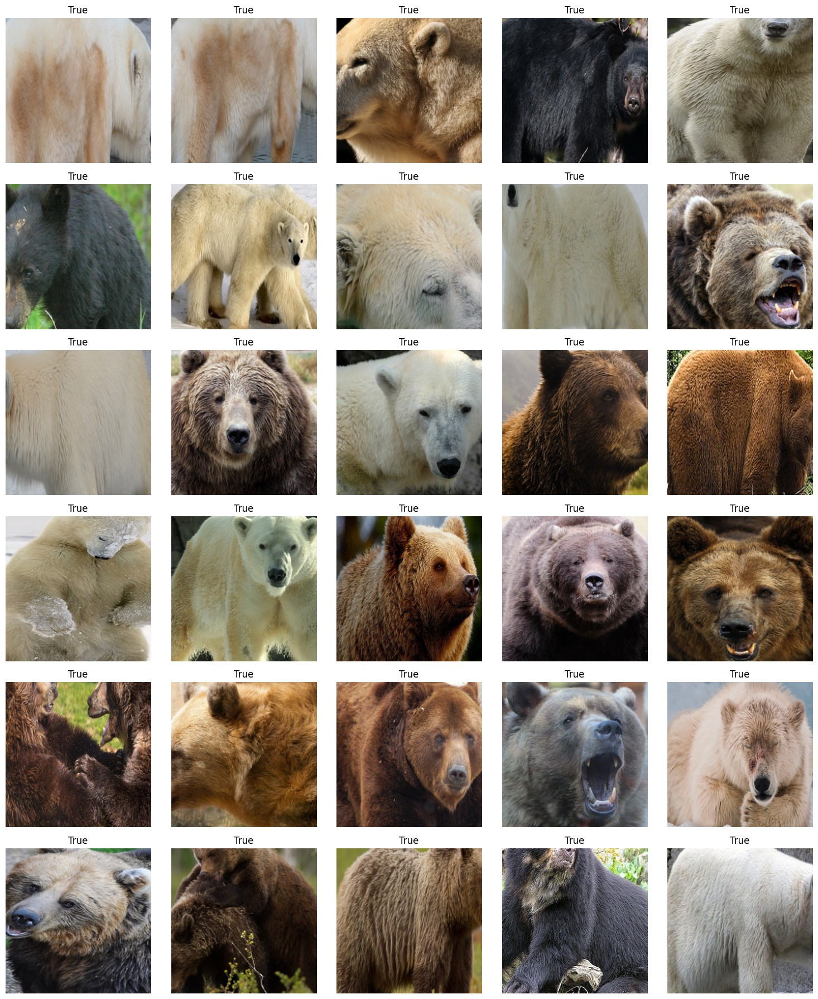

In [14]:
image_paths = []
for root_dir, dirs, files in os.walk(output_dir):
    for file in files:
        if file.lower().endswith(".png"):
            image_paths.append(os.path.join(root_dir, file))

print(f"Number of images: {len(image_paths)}")

with ThreadPoolExecutor() as executor:
    images = np.array(list(executor.map(process_image, image_paths)))
labels = np.ones(len(images), dtype=np.bool_)

plot_images(
    images[:30],
    ncols=5,
    labels=labels[:30],
)

In [15]:
save("landscape", images, labels)

Train length: 8259
Validation length: 1032
Test length: 1033


# Combine to final dataset

In [2]:
all_files = os.listdir(RESULTS_DIR)

wit_train_files = []
wit_val_files = []
wit_test_files = []

remaining_train_files = []
remaining_val_files = []
remaining_test_files = []

for file in all_files:
    if not file.endswith(".npz"):
        continue

    if file.startswith("train"):
        wit_train_files.append(file)
    elif file.startswith("val"):
        wit_val_files.append(file)
    elif file.startswith("test"):
        wit_test_files.append(file)
    elif "train" in file:
        remaining_train_files.append(file)
    elif "val" in file:
        remaining_val_files.append(file)
    elif "test" in file:
        remaining_test_files.append(file)

In [3]:
for files, target_name in [
    (wit_train_files, "wit_train"),
    (wit_val_files, "wit_val"),
    (wit_test_files, "wit_test"),
    (remaining_train_files, "rest_train"),
    (remaining_val_files, "rest_val"),
    (remaining_test_files, "rest_test"),
]:
    false_num = true_num = 0
    for file in files:
        data = np.load(os.path.join(RESULTS_DIR, file))
        images = data["images"]
        labels = data["labels"]

        false_mask = labels == 0
        for image in images[false_mask]:
            image_path = os.path.join(RESULTS_DIR, target_name, "0", f"{false_num}.png")
            os.makedirs(os.path.dirname(image_path), exist_ok=True)
            Image.fromarray(image).save(image_path)
            false_num += 1

        for image in images[~false_mask]:
            image_path = os.path.join(RESULTS_DIR, target_name, "1", f"{true_num}.png")
            os.makedirs(os.path.dirname(image_path), exist_ok=True)
            Image.fromarray(image).save(image_path)
            true_num += 1

        print(
            f"Saved {len(images)} images from {file} to {target_name} ({false_num} false, {true_num} true)"
        )

Saved 1000 images from train_0.npz to wit_train (348 false, 652 true)
Saved 1000 images from train_1.npz to wit_train (671 false, 1329 true)
Saved 1000 images from train_10.npz to wit_train (1018 false, 1982 true)
Saved 1000 images from train_11.npz to wit_train (1356 false, 2644 true)
Saved 1000 images from train_12.npz to wit_train (1672 false, 3328 true)
Saved 1000 images from train_13.npz to wit_train (2031 false, 3969 true)
Saved 1000 images from train_14.npz to wit_train (2357 false, 4643 true)
Saved 1000 images from train_15.npz to wit_train (2658 false, 5342 true)
Saved 1000 images from train_16.npz to wit_train (2968 false, 6032 true)
Saved 1000 images from train_17.npz to wit_train (3311 false, 6689 true)
Saved 1000 images from train_18.npz to wit_train (3641 false, 7359 true)
Saved 1000 images from train_19.npz to wit_train (3988 false, 8012 true)
Saved 1000 images from train_2.npz to wit_train (4312 false, 8688 true)
Saved 1000 images from train_20.npz to wit_train (4650 fa